# Lending cub case study

In [132]:
# Import libraries
import pandas as pd
import numpy as np
import warnings
import plotly.offline as py
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.offline as py 
py.init_notebook_mode(connected=True) 
import plotly.graph_objs as go
import plotly.tools as tls

In [133]:
# Read the dataset
loan = pd.read_csv('loan.csv')

C:\Users\Admin\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3444: DtypeWarning:

Columns (47) have mixed types.Specify dtype option on import or set low_memory=False.



In [134]:
loan.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
4,1075358,1311748,3000,3000,3000.0,60 months,12.69%,67.79,B,B5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN


In [135]:
# Note the % of missing values in each column
percent_missing = loan.isnull().sum() * 100 / len(loan)
percent_missing_df = pd.DataFrame({'column_name': loan.columns,
                                 'percent_missing': percent_missing})

In [136]:
# Filter for columns having more than 50% of missing rows
percent_missing_df = percent_missing_df[percent_missing_df['percent_missing'] > 50]

In [137]:
# Drop the columns having > than 50% missing values
print('Total number of columns : ', loan.shape[1])
loan.drop(percent_missing_df['column_name'].tolist(), axis = 1, inplace = True)
print('Number of columns after dropping columns with high missing value : ', loan.shape[1])

Total number of columns :  111
Number of columns after dropping columns with high missing value :  54


In [138]:
# Dropping columns which give information about customer behaviour; 
# These are necessary when taking a decision to approve the loan or not. But in this case, loans are already approved.
loan.drop(['delinq_2yrs',
'earliest_cr_line',
'inq_last_6mths',
'open_acc',
'revol_bal',
'out_prncp',
'out_prncp_inv',
'total_pymnt',
'total_pymnt_inv',
'total_rec_prncp',
'total_rec_int',
'total_rec_late_fee',
'recoveries',
'collection_recovery_fee',
'last_pymnt_d',
'last_pymnt_amnt',
'last_credit_pull_d',
'application_type'], axis=1, inplace=True)

# Dropping URL column - does not give any adequate information
# Dropping emp_title - as title is replaced by names after 2013, so does not give muchh importance
# id and member_id are both unqiue, so considerng just the id
# desc - Similar to purpose
# funded_amnt - Lookiing only at the initial amount requested and the final amout sactioned
# pymnt_plan -  Has only one payment paln - 'n'
# title - Gives similar information as purpose column (has fewer unique values)
# initial_list_status - Has only one payment paln - 'f'
# collections_12_mths_ex_med - Has only 0's in values
# chargeoff_within_12_mths
# delinq_amnt
# dropping loan amount as it is very similar to funded amt inv 

loan.drop(['url', 'id', 'emp_title', 'desc', 'funded_amnt', 'pymnt_plan', 'title', 'initial_list_status', 'loan_amnt',
           'collections_12_mths_ex_med','policy_code','acc_now_delinq','chargeoff_within_12_mths','delinq_amnt','tax_liens'],
          axis=1, inplace=True)

In [139]:
print('Number of columns to consider : ', loan.shape[1])

Number of columns to consider :  21


In [140]:
loan.dtypes

member_id                 int64
funded_amnt_inv         float64
term                     object
int_rate                 object
installment             float64
grade                    object
sub_grade                object
emp_length               object
home_ownership           object
annual_inc              float64
verification_status      object
issue_d                  object
loan_status              object
purpose                  object
zip_code                 object
addr_state               object
dti                     float64
pub_rec                   int64
revol_util               object
total_acc                 int64
pub_rec_bankruptcies    float64
dtype: object

In [141]:
# Cleaning term and int_rate columns and changing the data types
loan['term'] = loan['term'].apply(lambda x : x.replace(' months', '')).astype(int)
loan['int_rate'] = loan['int_rate'].apply(lambda x : x.replace('%', '')).astype(float)

In [142]:
# Replace 10+ as 10 and <1 as 1
loan['emp_length'] = loan['emp_length'].astype(str)
loan['emp_length'] = loan['emp_length'].apply(lambda x : x.replace(' years', ''))
loan['emp_length'] = loan['emp_length'].apply(lambda x : x.replace(' year', ''))
loan['emp_length'] = loan['emp_length'].apply(lambda x : x.replace('+', ''))
loan['emp_length'] = loan['emp_length'].apply(lambda x : x.replace('< ', ''))#.astype(int)
loan['emp_length'] = pd.to_numeric(loan['emp_length'], errors='coerce')

In [143]:
# changing the revol util to numeric type
loan['revol_util'] = (loan['revol_util']).astype(str).apply(lambda x : x.replace('%', '')).astype(float)
loan['revol_util'] = pd.to_numeric(loan['revol_util'], errors='coerce')

In [144]:
# changing the revol util to numeric type
loan['pub_rec_bankruptcies'] = pd.to_numeric(loan['pub_rec_bankruptcies'], errors='coerce')

In [145]:
#Consider only when the amount lended was > 0
loan = loan[(loan["funded_amnt_inv"] > 0)]

In [146]:
loan.describe()

,member_id,funded_amnt_inv,term,int_rate,installment,emp_length,annual_inc,dti,pub_rec,revol_util,total_acc,pub_rec_bankruptcies
count,3.958800e+04,39588.000000,39588.000000,39588.000000,39588.000000,38513.000000,3.958800e+04,39588.000000,39588.000000,39539.000000,39588.000000,38892.000000
mean,8.520944e+05,10431.329612,42.438921,12.025695,325.020770,5.096123,6.900537e+04,13.321370,0.055067,48.858008,22.096848,0.043274
std,2.645646e+05,7115.262677,10.633779,3.728447,209.006628,3.407908,6.383326e+04,6.676537,0.237234,28.327833,11.401022,0.204358
min,7.069900e+04,0.000121,36.000000,5.420000,15.690000,1.000000,4.000000e+03,0.000000,0.000000,0.000000,2.000000,0.000000
25%,6.682262e+05,5000.000000,36.000000,9.250000,167.087500,2.000000,4.050000e+04,8.190000,0.000000,25.400000,14.000000,0.000000
50%,8.521775e+05,8996.421297,36.000000,11.860000,280.970000,4.000000,5.900000e+04,13.410000,0.000000,49.300000,20.000000,0.000000
75%,1.047860e+06,14400.000000,60.000000,14.590000,431.370000,9.000000,8.250000e+04,18.600000,0.000000,72.400000,29.000000,0.000000
max,1.314167e+06,35000.000000,60.000000,24.590000,1305.190000,10.000000,6.000000e+06,29.990000,4.000000,99.900000,90.000000,2.000000


In [147]:
# Consider only the fully paid and charged off, current is ambigious
loan = loan[(loan['loan_status'] != 'Current')]

In [148]:
px.box(loan['funded_amnt_inv'])

In [149]:
loan[loan['funded_amnt_inv'] > 27500]['loan_status'].value_counts()

Fully Paid     823
Charged Off    211
Name: loan_status, dtype: int64

##### Removing data greater than 75% would bias the pattern identification

In [150]:
px.box(loan['annual_inc'])

In [151]:
loan.loc[loan['annual_inc'] > 145000] = np.nan

# Outlier treatment for annual inc column, considering the 1.5 IQR
# Considering the annual income to be <= 145000 - replace values > 145000, so that we do not have information loss

In [152]:
px.box(loan['total_acc'])

### Heatmap for finding correlation between variables

In [153]:
fig = px.imshow(loan.corr())
fig.show()

##### Except for corrrelation between funded amount inv and installment, pub_rec and pub_rec_bankrutcies, no significant positive or negative correlation found between other variables

### Univariate analysis - Unordered categorical variables

In [154]:
loan['loan_status'].value_counts()

Fully Paid     31286
Charged Off     5404
Name: loan_status, dtype: int64

In [155]:
loan_charged_off = loan[loan['loan_status'] == 'Charged Off']
loan_full_paid = loan[loan['loan_status'] == 'Fully Paid']

#### 1. Loan purpose

In [156]:
purpose_fp = loan_full_paid.groupby(['purpose'])['member_id'].count().reset_index()
purpose_fp.sort_values(['member_id'], ascending=False, inplace=True)

In [157]:
purpose_fp['Rank'] = range(1,len(purpose_fp)+1)

In [158]:
purpose_fp

,purpose,member_id,Rank
2,debt_consolidation,14660,1
1,credit_card,4269,2
9,other,3087,3
4,home_improvement,2259,4
6,major_purchase,1829,5
0,car,1294,6
11,small_business,1175,7
13,wedding,800,8
7,medical,536,9
8,moving,457,10


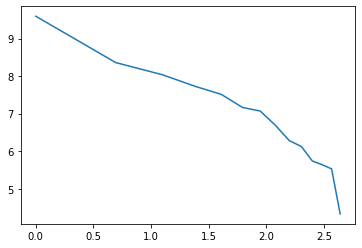

In [159]:
plt.plot(np.log(purpose_fp['Rank']), np.log(purpose_fp['member_id']))

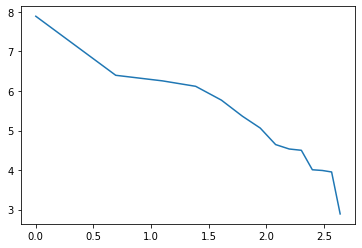

In [160]:
loan_charged_off = loan[loan['loan_status'] == 'Charged Off']

purpose_d = loan_charged_off.groupby(['purpose'])['member_id'].count().reset_index()
purpose_d.sort_values(['member_id'], ascending=False, inplace=True)

purpose_d['Rank'] = range(1,len(purpose_d)+1)

#plt.plot(purpose_fp['Rank'], purpose_fp['member_id'], log="xy")
plt.plot(np.log(purpose_d['Rank']), np.log(purpose_d['member_id']))

In [161]:
purpose_d

,purpose,member_id,Rank
2,debt_consolidation,2672,1
9,other,600,2
1,credit_card,521,3
11,small_business,454,4
4,home_improvement,320,5
6,major_purchase,213,6
0,car,158,7
7,medical,104,8
13,wedding,93,9
8,moving,90,10


#### Since both the highest number of defaulters and fully paid members have the same loan purpose, the purpose of loan alone cannot be used to identify defaulters

#### 2. Distribution across states

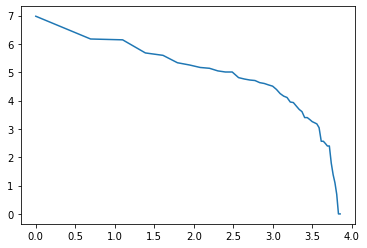

In [162]:
# address


purpose_d = loan_charged_off.groupby(['addr_state'])['member_id'].count().reset_index()
purpose_d.sort_values(['member_id'], ascending=False, inplace=True)

purpose_d['Rank'] = range(1,len(purpose_d)+1)

plt.plot(np.log(purpose_d['Rank']), np.log(purpose_d['member_id']))

In [163]:
purpose_d.head(5)

,addr_state,member_id,Rank
4,CA,1074,1
9,FL,481,2
30,NY,467,3
39,TX,294,4
27,NJ,270,5


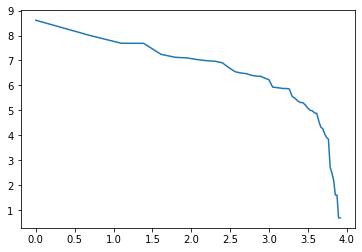

In [164]:
purpose_fp = loan_full_paid.groupby(['addr_state'])['member_id'].count().reset_index()
purpose_fp.sort_values(['member_id'], ascending=False, inplace=True)

purpose_fp['Rank'] = range(1,len(purpose_fp)+1)

plt.plot(np.log(purpose_fp['Rank']), np.log(purpose_fp['member_id']))

In [165]:
purpose_fp.head(5)

,addr_state,member_id,Rank
4,CA,5493,1
33,NY,2993,2
42,TX,2185,3
9,FL,2178,4
30,NJ,1402,5


#### Since both the highest number of defaulters and fully paid members belong to same state, the state alone cannot be used to identify defaulters

## Univariate Analysis - ordered categorical variables

##### Considering probablities because the data set is unbalanced for loan status

In [166]:
px.bar(loan.groupby(['loan_status'])['member_id'].count())

In [167]:
# Function for plotting univariate plots

def univariate_(df_fp, df_d, general, bins, title, no_plot):
    #First plot
    tr0 = go.Histogram(
        x=df_fp,
        nbinsx=bins,
        histnorm='probability',
        name="Fully paid"
    )
    #Second plot
    tr1 = go.Histogram(
        x=df_d,
        nbinsx=bins,
        histnorm='probability',
        name="Defaulted"
    )
    #Third plot
    tr2 = go.Histogram(
        x=df_emp_length,
        nbinsx=bins,
        histnorm='probability',
        name="Overall"
    )
    
    if (no_plot == 3) :

        #Creating the grid
        fig = tls.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                                  subplot_titles=('Fully paid','Defaulted', 'General Distribution'))

        #setting the figs
        fig.append_trace(tr0, 1, 1)
        fig.append_trace(tr1, 1, 2)
        fig.append_trace(tr2, 2, 1)
        
    else :
        
        fig = tls.make_subplots(rows=1, cols=2, specs=[[{}, {}]],
                          subplot_titles=('Fully paid','Defaulted'))
        #setting the figs
        fig.append_trace(tr0, 1, 1)
        fig.append_trace(tr1, 1, 2)

    fig['layout'].update(showlegend=True, title=title, bargap=0.05)
    py.iplot(fig, filename='custom-sized-subplot-with-subplot-titles')

### Distribution of funded amount inv

In [168]:
# Filtering for loan status and considering the required columns

df_fp = loan.loc[loan["loan_status"] == 'Fully Paid']['funded_amnt_inv'].values.tolist()
df_d = loan.loc[loan["loan_status"] == 'Charged Off']['funded_amnt_inv'].values.tolist()
df_emp_length = loan['funded_amnt_inv'].values.tolist()

univariate_(df_fp, df_d, general = df_emp_length, bins = 7, title = 'Funded loan Distribution', no_plot = 3)

C:\Users\Admin\anaconda3\lib\site-packages\plotly\tools.py:461: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



##### When the funded amount is lower, people usually tend to pay back the entire loan; When the funded amount increases ( >15k), members tend to not repay and are charged off

#### Income

In [169]:
# Filtering for loan status and considering the required columns

df_fp = loan.loc[loan["loan_status"] == 'Fully Paid']['annual_inc'].values.tolist()
df_d = loan.loc[loan["loan_status"] == 'Charged Off']['annual_inc'].values.tolist()
df_emp_length = loan['annual_inc'].values.tolist()

univariate_(df_fp, df_d, general = df_emp_length, bins = 9, title = 'Income Distribution', no_plot = 3)

##### The probability of defaulters in less income range (<50K) is higher

#### Interest rate

In [170]:
# Filtering for loan status and considering the required columns

df_fp = loan.loc[loan["loan_status"] == 'Fully Paid']['int_rate'].values.tolist()
df_d = loan.loc[loan["loan_status"] == 'Charged Off']['int_rate'].values.tolist()
df_emp_length = loan['int_rate'].values.tolist()

univariate_(df_fp, df_d, general = df_emp_length, bins = 9, title = 'Intrest rate Distribution', no_plot = 3)

##### when the intrest rates are lower, the loan was fully paid, higher intrest rates (>15%) saw higher number of defaulters

#### Employment length

In [171]:
# Filtering for loan status and considering the required columns

df_fp = loan.loc[loan["loan_status"] == 'Fully Paid']['emp_length'].values.tolist()
df_d = loan.loc[loan["loan_status"] == 'Charged Off']['emp_length'].values.tolist()
df_emp_length = loan['emp_length'].values.tolist()

univariate_(df_fp, df_d, general = df_emp_length, bins = 9, title = 'Employment years Distribution', no_plot = 3)

##### The number of employement years do not differ much for fully paid and defaulters; Max probability of defaulters are seen in 10+ years of experience - Scope to deep dive

In [172]:
# Check for any insights after filtering the data for 10+ years of experience

In [173]:
df_fp_10 = loan.loc[(loan["loan_status"] == 'Fully Paid') & (loan["emp_length"] == 10)]['purpose'].values.tolist()
df_d_10 = loan.loc[(loan["loan_status"] == 'Charged Off') & (loan["emp_length"] == 10)]['purpose'].values.tolist()

univariate_(df_fp_10, df_d_10, general = df_emp_length, bins = 9, title = 'Emp len - 10; Purpose', no_plot = 2)

##### People with 10+ years of exp and own a small business have a slightly higher probability of defaulting

In [174]:
df_fp_10 = loan.loc[(loan["loan_status"] == 'Fully Paid') & (loan["emp_length"] == 10) & (loan["purpose"] == "debt_consolidation")]['total_acc'].values.tolist()
df_d_10 = loan.loc[(loan["loan_status"] == 'Charged Off') & (loan["emp_length"] == 10) & (loan["purpose"] == "debt_consolidation")]['total_acc'].values.tolist()

univariate_(df_fp_10, df_d_10, general = df_emp_length, bins = 9, title = 'len -10; Purpose - debt', no_plot = 2)

#### Members having 10+ years of emp length who have taken the loan for debt consolidation and having higher credit lines are more likely to get a charge off

In [175]:
# Check for any insights after filtering the data for 10+ years of experience wrt State

In [176]:
df_fp = loan.loc[(loan["loan_status"] == 'Fully Paid')]['addr_state'].values.tolist()
df_d = loan.loc[(loan["loan_status"] == 'Charged Off')]['addr_state'].values.tolist()

univariate_(df_fp, df_d, general = df_emp_length, bins = 9, title = 'addr_state distribution', no_plot = 2)

In [177]:
# Filter out for CA to check if there is any significant difference

In [178]:
df_fp = loan.loc[(loan["loan_status"] == 'Fully Paid') & (loan["addr_state"].isin(['CA']))]['zip_code'].values.tolist()
df_d = loan.loc[(loan["loan_status"] == 'Charged Off') & (loan["addr_state"].isin(['CA']))]['zip_code'].values.tolist()

univariate_(df_fp, df_d, general = df_emp_length, bins = 9, title = 'CA - zip_code', no_plot = 2)

##### Within CA, the zip codes starting with 917 and 926 have a slightly higher proabability of defaulting

In [179]:
# Purpose

In [180]:
df_fp = sorted(loan.loc[(loan["loan_status"] == 'Fully Paid')]['purpose'].values.tolist())
df_d = sorted(loan.loc[(loan["loan_status"] == 'Charged Off')]['purpose'].values.tolist())
df_emp_length = loan['purpose'].values.tolist()

univariate_(df_fp, df_d, general = df_emp_length, bins = 9, title = 'purpose', no_plot = 3)

##### Only for Small business, there is slightly higher chance of the member defaulting

In [181]:
df_fp_10 = loan.loc[(loan["loan_status"] == 'Fully Paid') & (loan["purpose"] == "debt_consolidation")]['total_acc'].values.tolist()
df_d_10 = loan.loc[(loan["loan_status"] == 'Charged Off') & (loan["purpose"] == "debt_consolidation")]['total_acc'].values.tolist()

univariate_(df_fp_10, df_d_10, general = df_emp_length, bins = 9, title = 'purpose - debt; total_acc', no_plot = 2)

##### higher defaulters when the credit account increase

In [182]:
# month

In [183]:
# extract month
loan['month'] = loan['issue_d'].astype(str).apply(lambda x : x[:3])

In [184]:
df_fp_10 = loan.loc[(loan["loan_status"] == 'Fully Paid')]['month'].values.tolist()
df_d_10 = loan.loc[(loan["loan_status"] == 'Charged Off')]['month'].values.tolist()
df_emp_length = loan['month'].values.tolist()

univariate_(df_fp_10, df_d_10, general = df_emp_length, bins = 9, title = 'Month distribution', no_plot = 2)

##### No significant difference in defaulters and full paid wrt month

In [185]:
# Grade distribution

In [186]:
df_fp_10 = sorted(loan.loc[(loan["loan_status"] == 'Fully Paid')]['grade'].values.tolist())
df_d_10 = sorted(loan.loc[(loan["loan_status"] == 'Charged Off')]['grade'].values.tolist())
df_emp_length = loan['grade'].values.tolist()

univariate_(df_fp_10, df_d_10, general = df_emp_length, bins = 9, title = 'grade distribution', no_plot = 3)

##### Higher grades (>C) are likely to have more number of charge offs

In [187]:
# Loan term

In [188]:
df_fp_10 = sorted(loan.loc[(loan["loan_status"] == 'Fully Paid')]['term'].values.tolist())
df_d_10 = sorted(loan.loc[(loan["loan_status"] == 'Charged Off')]['term'].values.tolist())
df_emp_length = loan['term'].values.tolist()

univariate_(df_fp_10, df_d_10, general = df_emp_length, bins = 2, title = 'term distribution', no_plot = 3)

##### Defaulters are likely to increase for long term loans

In [189]:
#Credit line distribution

In [190]:
df_fp_10 = sorted(loan.loc[(loan["loan_status"] == 'Fully Paid')]['total_acc'].values.tolist())
df_d_10 = sorted(loan.loc[(loan["loan_status"] == 'Charged Off')]['total_acc'].values.tolist())
df_emp_length = loan['total_acc'].values.tolist()

univariate_(df_fp_10, df_d_10, general = df_emp_length, bins = 9, title = 'Credit acc', no_plot = 3)

##### Not significant - total_acc

In [191]:
df_fp_10 = loan.loc[(loan["loan_status"] == 'Fully Paid') & (loan["purpose"] == "debt_consolidation")]['month'].values.tolist()
df_d_10 = loan.loc[(loan["loan_status"] == 'Charged Off') & (loan["purpose"] == "debt_consolidation")]['month'].values.tolist()

univariate_(df_fp_10, df_d_10, general = df_emp_length, bins = 12, title = 'month distribution', no_plot = 2)

##### The purpose - debt consolidation is higher in both the loan status, however, in defaulters, it is slightly higher in the last few months of the year

In [192]:
# pub rec

In [193]:
df_fp_10 = sorted(loan.loc[(loan["loan_status"] == 'Fully Paid')]['pub_rec'].values.tolist())
df_d_10 = sorted(loan.loc[(loan["loan_status"] == 'Charged Off')]['pub_rec'].values.tolist())
df_emp_length = loan['pub_rec'].values.tolist()

univariate_(df_fp_10, df_d_10, general = df_emp_length, bins = 9, title = 'pub_rec distribution', no_plot = 3)

##### Members having  1 or more derogatory records tend to charge off

In [67]:
# Creating bins for continuous variables

loan['funded_amt_cat'] = pd.cut(loan['funded_amnt_inv'], bins=5 ,labels=['very low', 'low', 'medium', 'high', 'very high'])
loan['income_cat'] = pd.cut(loan.annual_inc, bins=5 ,labels=['very low', 'low', 'medium', 'high', 'very high'])
loan['int_rate_cat'] = pd.cut(loan.int_rate, bins=5 ,labels=['very low', 'low', 'medium', 'high', 'very high'])

In [70]:
# Checking if installment to be paid is higher than the monthly income

loan['monthly_inc'] = loan['annual_inc']/12
print('Installment > monthly loan amt : ' , (len(loan[loan['installment'] > loan['monthly_inc']])))

Installment > monthly loan amt :  0


# Bivariate Analysis

In [124]:
def bivariate_(df_fp, df_d, y1, x1, title_y, title_x) : 
    tr0 = go.Box(
        y=df_fp[y1],
        x=df_fp[x1],
        name='Fully paid',
        marker=dict(
            color='#3D9970'
        )
    )

    tr1 = go.Box(
        y=df_d[y1],
        x=df_d[x1],
        name='Charged off',
        marker=dict(
            color='#FF4136'
        )
    )

    data = [tr0, tr1]

    layout = go.Layout(
        yaxis=dict(
            title = title_y,
            zeroline=False
        ),
        xaxis=dict(
            title = title_x
        ),
        boxmode='group'
    )
    fig = go.Figure(data=data, layout=layout)

    py.iplot(fig, filename='box-age-cat')

In [125]:
# Checking the relationship between funded amount and grade

df_fp = loan.loc[loan["loan_status"] == 'Fully Paid']
df_d = loan.loc[loan["loan_status"] == 'Charged Off']

bivariate_(df_fp, df_d, y1 = 'funded_amnt_inv', x1 = 'grade', title_y = 'Loan amt', title_x = 'grade' )

In [126]:
# Checking the realtionship between funded amount and month

df_fp = loan.loc[loan["loan_status"] == 'Fully Paid']
df_d = loan.loc[loan["loan_status"] == 'Charged Off']

bivariate_(df_fp, df_d, y1 = 'funded_amnt_inv', x1 = 'month', title_y = 'Loan amt', title_x = 'Month' )

In [127]:
# Checking the realtionship between funded amount and purpose for the month of dec

df_fp = loan.loc[(loan["loan_status"] == 'Fully Paid') & (loan["month"] == 'Dec')]
df_d = loan.loc[(loan["loan_status"] == 'Charged Off') & (loan["month"] == 'Dec')]

bivariate_(df_fp, df_d, y1 = 'funded_amnt_inv', x1 = 'purpose', title_y = 'Loan amt', title_x = 'Purpose' )

##### Not signicant change in vacation for dec month; 
##### December being the holiday period might see an increase in marriage loans  which might get charged off
##### End of year might observe higher defaulters in small business

In [130]:
# # Checking the realtionship between funded loan amount and purpose for the month of aug and sep

df_fp = loan.loc[(loan["loan_status"] == 'Fully Paid') & (loan["month"].isin(['Aug','Sep']))]
df_d = loan.loc[(loan["loan_status"] == 'Charged Off') & (loan["month"].isin(['Aug','Sep']))]

bivariate_(df_fp, df_d, y1 = 'funded_amnt_inv', x1 = 'purpose', title_y = 'Loan amt', title_x = 'Purpose' )

##### Schools and collges usually start in the month of AUG / SEPT, so educational loans taken are higher and so is the defaulters;
##### Loans taken on renewable energy is also higher in aug-sep

In [196]:
# Checking the realtionship between funded amount and states when month = Aug , sep and pupose = renewable

df_fp = loan.loc[(loan["loan_status"] == 'Fully Paid') & (loan["month"].isin(['Aug','Sep']) & (loan["purpose"] == 'renewable_energy'))]['addr_state'].values.tolist()
df_d = loan.loc[(loan["loan_status"] == 'Charged Off') & (loan["month"].isin(['Aug','Sep']) & (loan["purpose"] == 'renewable_energy'))]['addr_state'].values.tolist()

univariate_(df_fp, df_d, general = df_emp_length, bins = 9, title = 'State distribution', no_plot = 2)

##### Missouri - MO, has a higher number of defaulters in AUgust to Sept month; its primary renewable electricity sources are wind energy and hydro energy; According to EIA, capacity factors for wind power fall in august-sept, which would be a good deal to own them or invest in them; This period we see higher number of defaulters